This is my model I am building to enhance a low light image

First I will generate a low light image from a normal image

image number 19 downloaded.


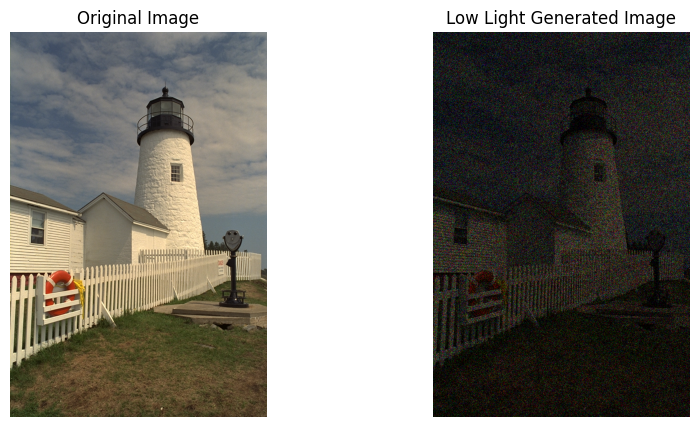

In [ ]:
from urllib.request import urlretrieve
import numpy as np
import cv2  #opencv library
import matplotlib.pyplot as plt
import os

i = 19
imgname = 'kodim19.png'
url = "http://r0k.us/graphics/kodak/kodak/" + imgname
print ('Downloading', url)
urlretrieve(url, imgname)
print ('image number', i, 'downloaded.')
#just for sample purposes
orig = cv2.imread(imgname,-1)
orig = orig[:,:,::-1]

def darken_image(src):
  img = cv2.imread(src,-1)  #the -1 reads the image data unchanged
  img = img[:, :, ::-1] # reversing the seq of BGR to RGB

  img = img.astype('float')/255.0
  img.min(), img.max(), img.mean()

  mean_ppp = 1.0   # photons per pixel (averaged over the whole image)

  img_rescaled = img / img.mean() * mean_ppp

  pois_img = np.random.poisson(img_rescaled).astype('float')
  low_light_image = np.array(pois_img / pois_img.max())
  return low_light_image

sample = darken_image(imgname)

plt.figure(figsize=(10,5))
plt.subplot(121)
plt.title('Original Image')
plt.imshow(orig)
_=plt.axis('off')
plt.subplot(122)
#plt.imshow(pois_img.clip(min=0.0,max=1.0))
plt.title('Low Light Generated Image')
plt.imshow(sample)
_=plt.axis('off')

You can see our function successfully turned the light image into a dark image! Now we will load in the rest of our data.

In [ ]:
images = []
images.append(sample)

def load_images(images):
  for i in range(1,12):
    if i < 10:
      imgname = f'kodim0{i}.png'
    else:
      imgname = f'kodim{i}.png'
    url = "http://r0k.us/graphics/kodak/kodak/" + imgname
    urlretrieve(url, imgname)
    print ('image number', i, 'downloaded.')
    images.append(darken_image(imgname))

load_images(images)





image number 1 downloaded.
image number 2 downloaded.
image number 3 downloaded.
image number 4 downloaded.
image number 5 downloaded.
image number 6 downloaded.
image number 7 downloaded.
image number 8 downloaded.
image number 9 downloaded.
image number 10 downloaded.
image number 11 downloaded.


Now we will create our model that will be trained on the low light image we generated

In [ ]:
import tensorflow as tf

def keras_model_to_tf_graph(keras_model, input_shape):
    # Define input tensor
    input_tensor = tf.keras.Input(shape=input_shape)

    # Get output tensor from Keras model
    output_tensor = keras_model(input_tensor)

    return input_tensor, output_tensor


In [ ]:
import tensorflow as tf
import cv2
import numpy as np
import matplotlib.pyplot as plt

def low_light_enhancement_model(input_shape):
    model = tf.keras.Sequential([
        #convolutional layers
        tf.keras.layers.Conv2D(64, (1, 1), activation='relu', padding='same', input_shape=input_shape),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.Conv2D(64, (1, 1), activation='relu', padding='same'),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.Conv2D(64, (1, 1), activation='relu', padding='same'),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.Conv2D(3, (3, 3), activation='linear', padding='same')
    ])
    return model

def preprocess_input(image):
    desired_height, desired_width = 768, 512
    resized_image = cv2.resize(image, (desired_width, desired_height))
    resized_image = resized_image[np.newaxis, ...]
    return resized_image

input_shape = (768, 512, 3)

#creating model
keras_model = low_light_enhancement_model(input_shape)
input_tensor, output_tensor = keras_model_to_tf_graph(keras_model, input_shape)
output_shape = (768, 512, 3)

loss = tf.losses.mean_squared_error(output_tensor, tf.keras.Input(shape=output_shape))
optimizer = tf.keras.optimizers.Adam()

epochs = []
loss_values = []
processed = []
num_epochs = 10

#preprocessing the images
for image in images:
    low_light_image_batch = preprocess_input(image)
    processed.append(low_light_image_batch)

#running epochs
for epoch in range(num_epochs):

    #running a training step
    with tf.GradientTape() as tape:
        output = keras_model(low_light_image_batch)
        #current_loss = tf.losses.mean_squared_error(output, low_light_image_batch)
        current_loss = tf.reduce_mean(tf.square(output - low_light_image_batch))

    #print("Epoch {}: Loss = {}".format(epoch+1, current_loss))
    #mean_epoch_loss = tf.reduce_mean(current_loss)
    mean_epoch_loss = current_loss.numpy()
    print("Epoch {}: Loss = {}".format(epoch+1, mean_epoch_loss))
    epochs.append(mean_epoch_loss)

    gradients = tape.gradient(current_loss, keras_model.trainable_variables)
    optimizer.apply_gradients(zip(gradients, keras_model.trainable_variables))

    loss_values.append(current_loss.numpy())

Epoch 1: Loss = 0.01273594330996275
Epoch 2: Loss = 0.008646529167890549
Epoch 3: Loss = 0.005870672408491373
Epoch 4: Loss = 0.004349484108388424
Epoch 5: Loss = 0.004121704958379269
Epoch 6: Loss = 0.004762394353747368
Epoch 7: Loss = 0.005117570515722036
Epoch 8: Loss = 0.004831003025174141
Epoch 9: Loss = 0.004269207362085581
Epoch 10: Loss = 0.003822099883109331


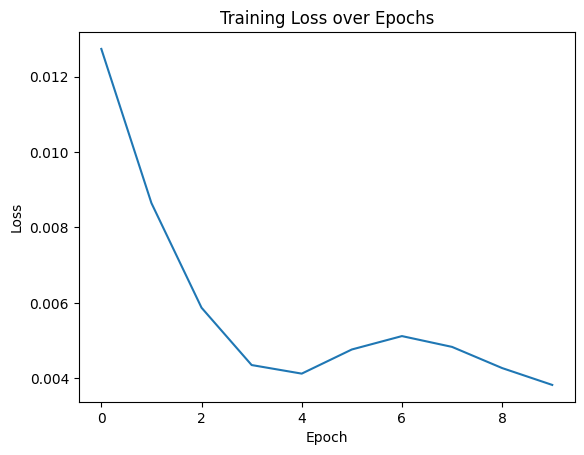

In [ ]:
loss_values_1d = np.ravel(loss_values)
plt.plot(epochs)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss over Epochs')
plt.show()

In [ ]:
from skimage.metrics import mean_squared_error, peak_signal_noise_ratio

total_psnr = 0
num_images = len(processed)
print(num_images)
for i in range(num_images):
    enhanced_image = keras_model.predict(processed[i])
    original_size = images[i].shape[:2][::-1]  #get original width and height
    enhanced_image = cv2.resize(enhanced_image[0], original_size)
    enhanced_image = np.clip(enhanced_image, 0, 1)
    enhanced_image = enhanced_image
    psnr = peak_signal_noise_ratio(images[i], enhanced_image, data_range=images[i].max())
    total_psnr += psnr

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.title('Denoised Image')
    plt.imshow(enhanced_image)
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Low Light Generated Image')
    plt.imshow(images[i])
    plt.axis('off')

    plt.show()
    print('Peak signal noise ratio: ', psnr)


In [ ]:
avg = total_psnr/num_images

print('This is the average Peak Signal Noise Ratio for every image: ', avg)

This is the average Peak Signal Noise Ratio for every image:  20.61909511246399


I will now try to implement the retinex theories into my current model

In [ ]:
import tensorflow as tf
import cv2
import numpy as np

def low_light_enhancement_model(input_shape):
    input_img = tf.keras.Input(shape=input_shape)

    #predict the illumination map
    x = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', padding='same')(input_img)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = tf.keras.layers.BatchNormalization()(x)

    illumination_map = tf.keras.layers.Conv2D(3, (3, 3), activation='relu', padding='same')(x)

    #compute the reflectance
    reflectance = tf.keras.layers.Lambda(lambda inputs: inputs[0] / (inputs[1] + 1e-6))([input_img, illumination_map])
    resized_illumination_map = tf.keras.layers.Lambda(lambda x: tf.image.resize(x, (768, 512)))(illumination_map)

    model = tf.keras.Model(inputs=input_img, outputs=[illumination_map, reflectance])
    return model

def preprocess_input(image):
    desired_height, desired_width = 768, 512
    resized_image = cv2.resize(image, (desired_width, desired_height))
    resized_image = resized_image[np.newaxis, ...]
    return resized_image

input_shape = (768, 512, 3)
keras_model = low_light_enhancement_model(input_shape)
optimizer = tf.keras.optimizers.Adam()

output_shape = (768, 512, 3)

#custom loss function
def retinex_loss(y_true, y_pred):
    illumination_loss = tf.reduce_mean(tf.square(y_pred[0] - y_true))
    reflectance_loss = tf.reduce_mean(tf.square(y_pred[1] - y_true))
    return illumination_loss + reflectance_loss

num_epochs = 10
loss_values = []
processed = []

for image in images:
    low_light_image_batch = preprocess_input(image)
    processed.append(low_light_image_batch)


for epoch in range(num_epochs):
    epoch_loss = 0
    with tf.GradientTape() as tape:
        predicted_illumination, predicted_reflectance = keras_model(low_light_image_batch)
        loss = retinex_loss(low_light_image_batch, [predicted_illumination, predicted_reflectance])
    gradients = tape.gradient(loss, keras_model.trainable_variables)
    optimizer.apply_gradients(zip(gradients, keras_model.trainable_variables))
    epoch_loss += loss.numpy()
    mean_epoch_loss = epoch_loss / len(images)
    print(f"Epoch {epoch+1}: Loss = {mean_epoch_loss}")
    loss_values.append(mean_epoch_loss)


Epoch 1: Loss = 558800042.6666666
Epoch 2: Loss = 405641.1666666667
Epoch 3: Loss = 0.24271275599797568
Epoch 4: Loss = 0.1249005397160848
Epoch 5: Loss = 0.07956937452157338
Epoch 6: Loss = 0.05652223527431488
Epoch 7: Loss = 0.04299794137477875
Epoch 8: Loss = 0.03432621310154597
Epoch 9: Loss = 0.02841973801453908
Epoch 10: Loss = 0.02421711136897405


In [ ]:
processed = [preprocess_input(image) for image in images]

In [ ]:
print(images[0].shape)

(768, 512, 3)


In [ ]:
print(processed[0].shape)

(1, 768, 512, 3)


12
1/1 [==============================] - 1s 1s/step


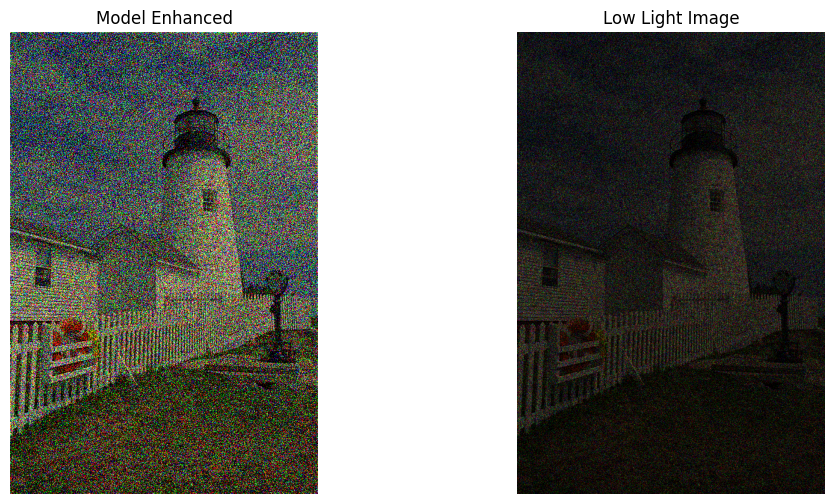

Peak signal noise ratio:  9.718204480711623
1/1 [==============================] - 1s 1s/step


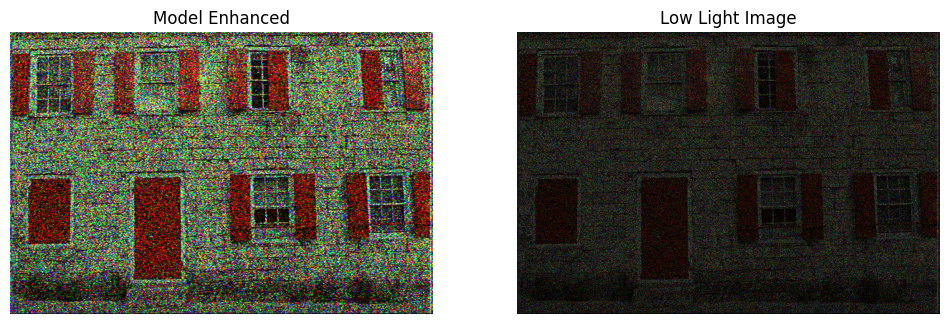

Peak signal noise ratio:  10.229864764190804
1/1 [==============================] - 1s 1s/step


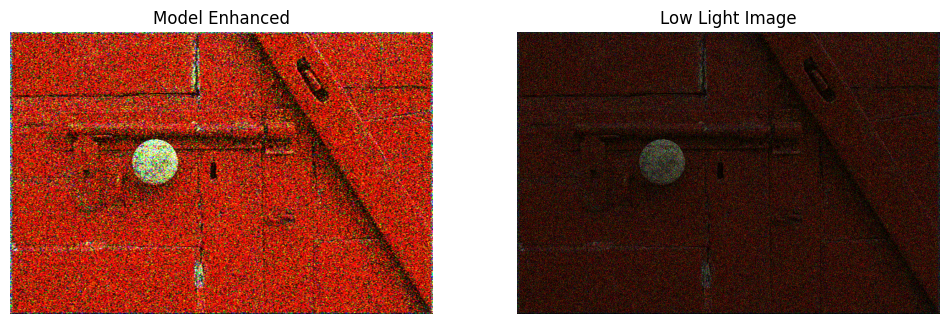

Peak signal noise ratio:  9.56249988870129
1/1 [==============================] - 2s 2s/step


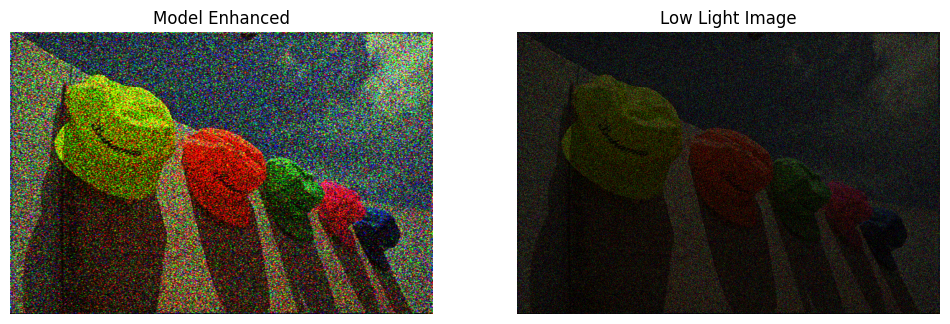

Peak signal noise ratio:  11.638381381177783
1/1 [==============================] - 2s 2s/step


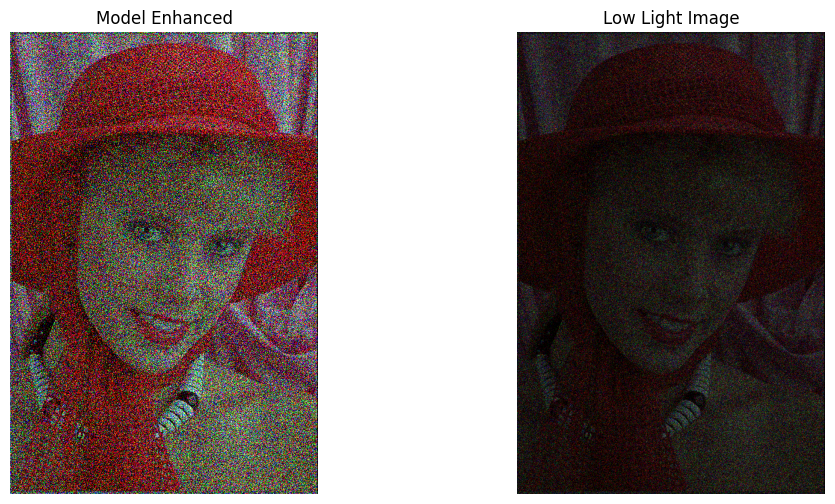

Peak signal noise ratio:  9.721968901474066
1/1 [==============================] - 2s 2s/step


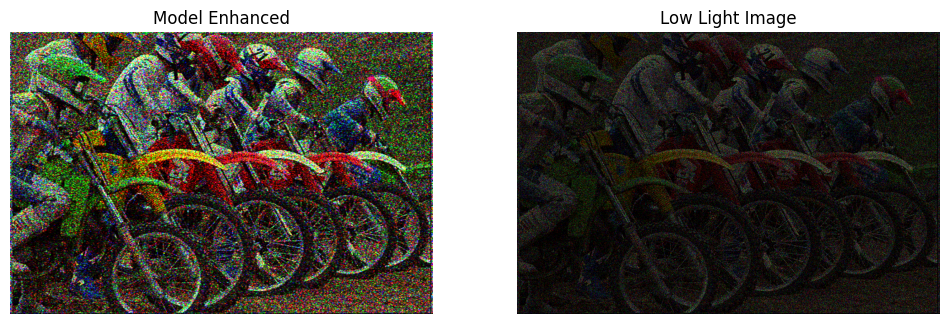

Peak signal noise ratio:  12.156921648101687
1/1 [==============================] - 1s 1s/step


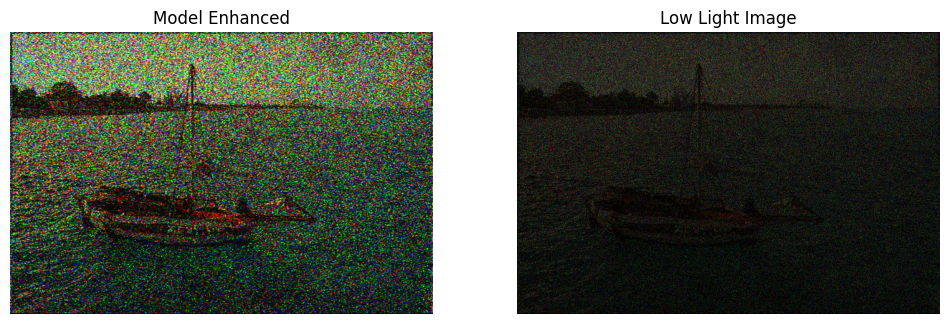

Peak signal noise ratio:  11.921514224616953
1/1 [==============================] - 1s 1s/step


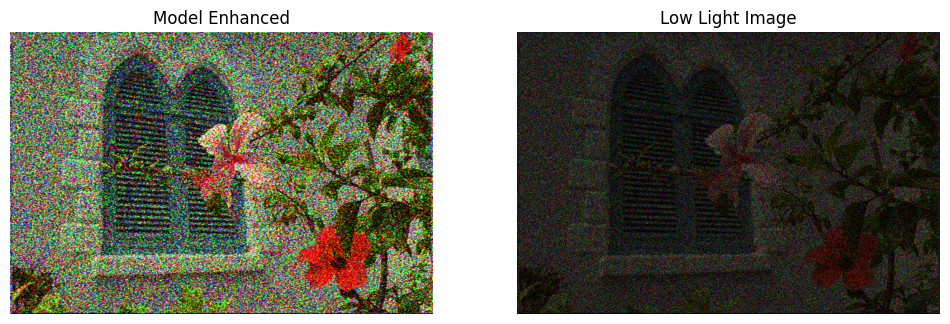

Peak signal noise ratio:  9.443327753921869
1/1 [==============================] - 1s 1s/step


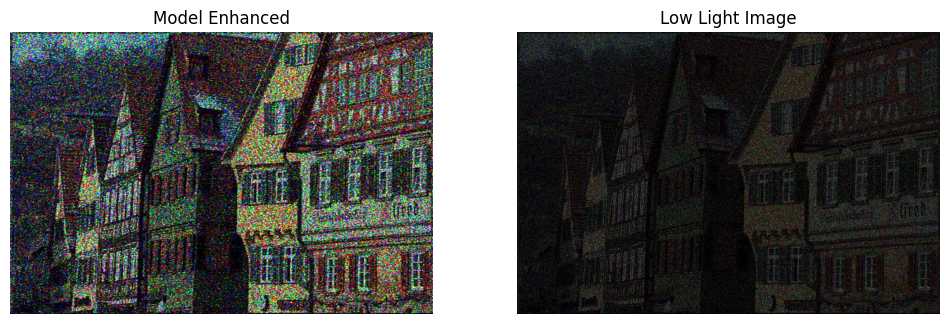

Peak signal noise ratio:  11.69064876799717
1/1 [==============================] - 1s 1s/step


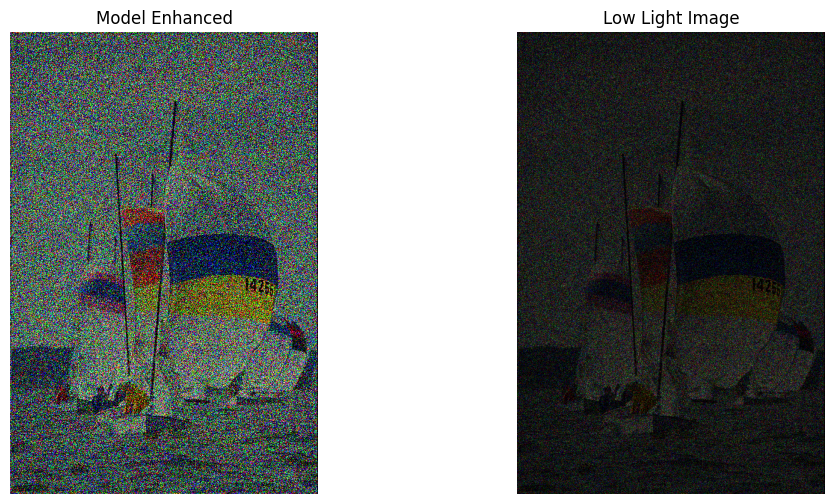

Peak signal noise ratio:  9.120858484009027
1/1 [==============================] - 2s 2s/step


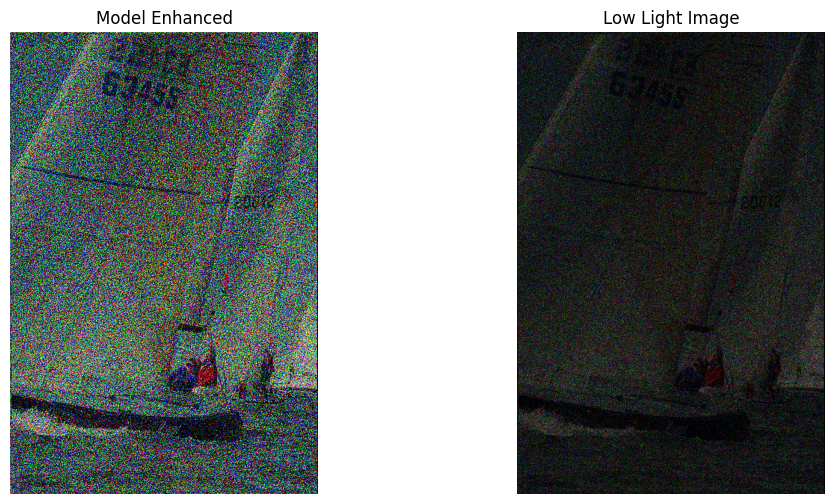

Peak signal noise ratio:  9.136518826729667
1/1 [==============================] - 2s 2s/step


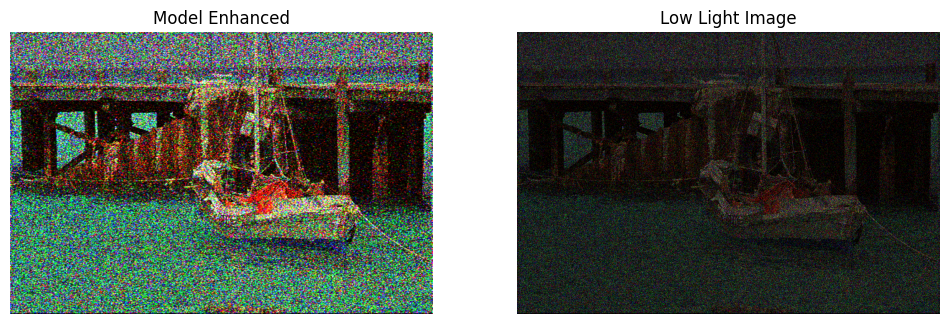

Peak signal noise ratio:  10.104431529206032


In [ ]:
from skimage.metrics import mean_squared_error, peak_signal_noise_ratio

total_psnr = 0
num_images = len(processed)
print(num_images)
enhanced = []
for i in range(num_images):
    illumination, reflectance = keras_model.predict(processed[i])

    enhanced_image = (illumination * 5) * (reflectance * reflectance)
    original_size = images[i].shape[:2][::-1]  #get original width and height
   # original_size = tuple(images[i].shape[1::-1])


    enhanced_image = cv2.resize(enhanced_image[0], original_size)
    enhanced_image = np.clip(enhanced_image, 0, 1)

    enhanced_image_display = (enhanced_image * 255).astype(np.uint8)
    enhanced.append(enhanced_image_display)

    psnr = peak_signal_noise_ratio(images[i], enhanced_image, data_range=images[i].max())
    total_psnr += psnr

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.title('Model Enhanced')
    plt.imshow(enhanced_image_display)
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Low Light Image')
    plt.imshow(images[i])
    plt.axis('off')

    plt.show()
    print('Peak signal noise ratio: ', psnr)


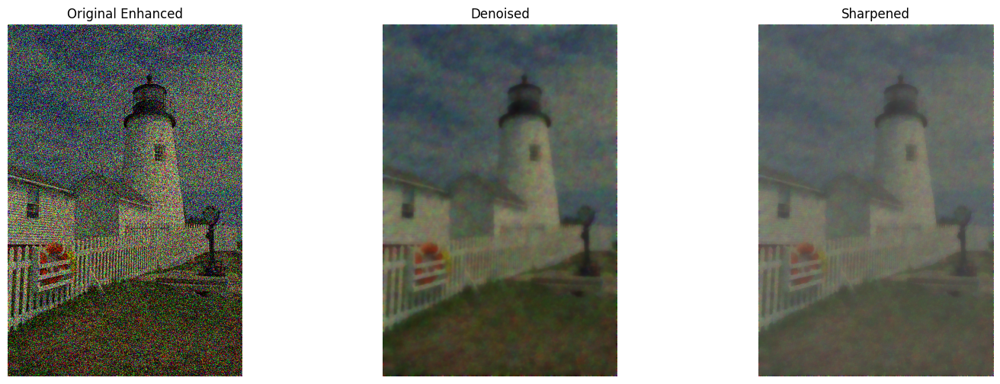

psnr enhanced, original 6.891539327041243


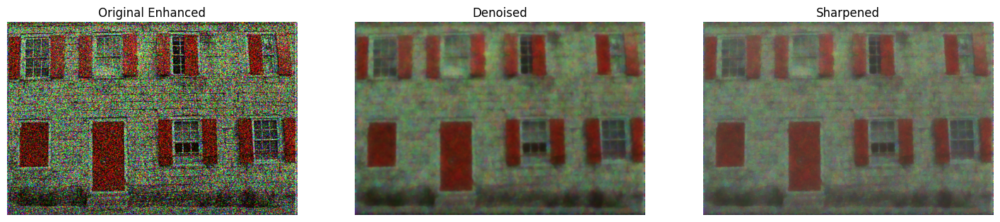

psnr enhanced, original 7.426613336310583


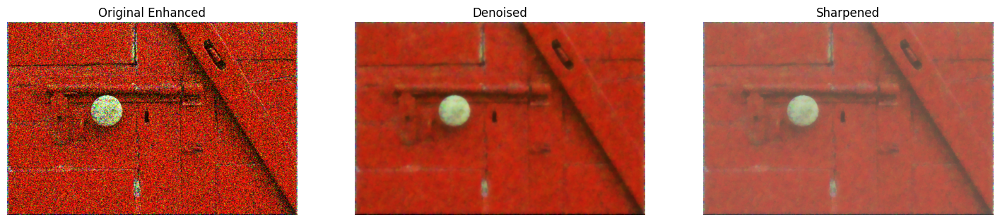

psnr enhanced, original 6.97384153697352


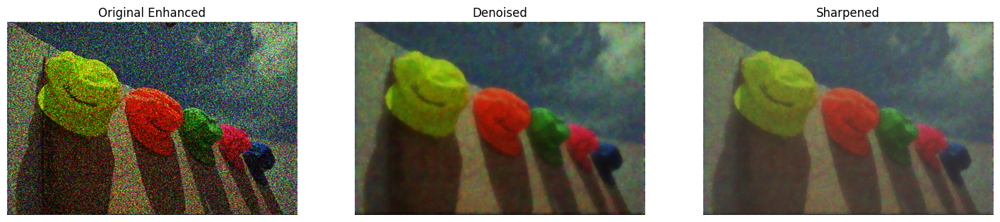

psnr enhanced, original 8.833563348096895


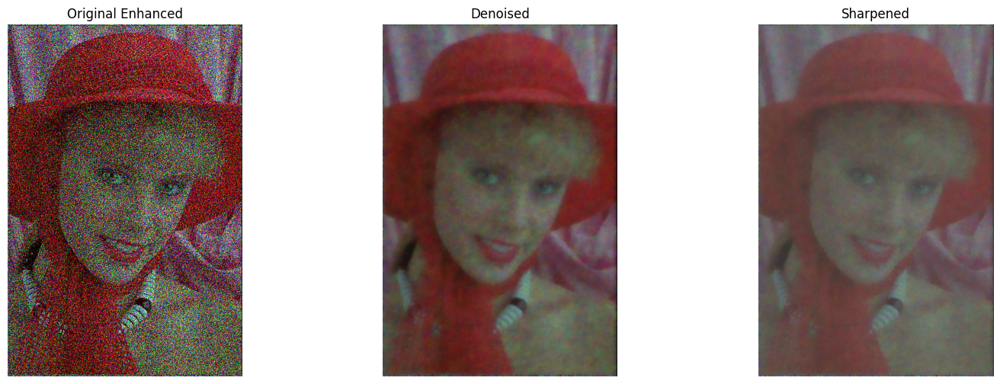

psnr enhanced, original 6.865565448313839


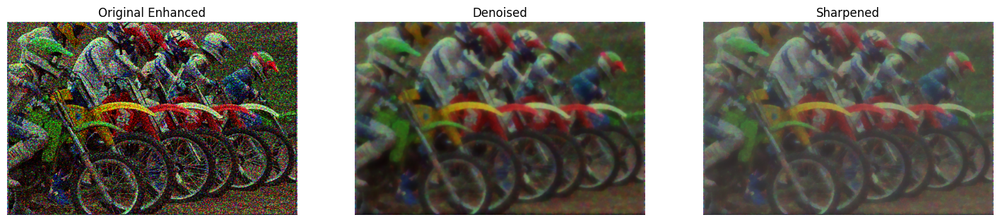

psnr enhanced, original 9.296563279425621


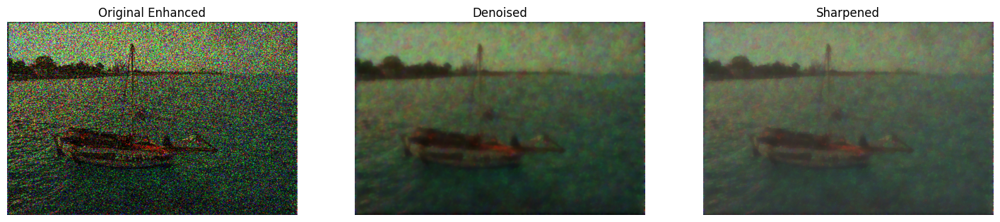

psnr enhanced, original 9.034667143923386


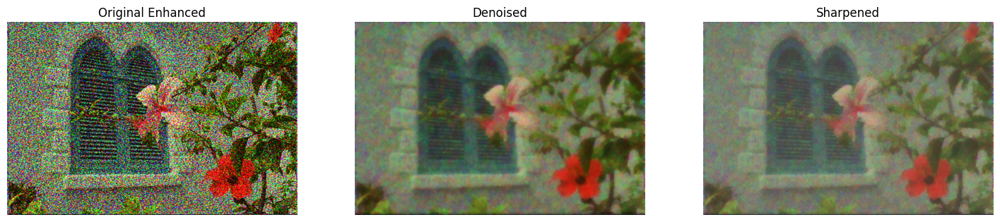

psnr enhanced, original 6.611496970052302


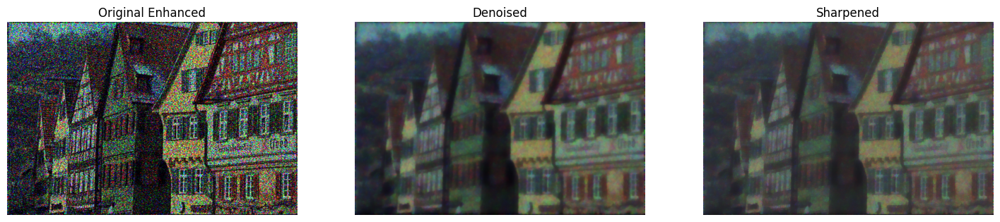

psnr enhanced, original 8.841777784718019


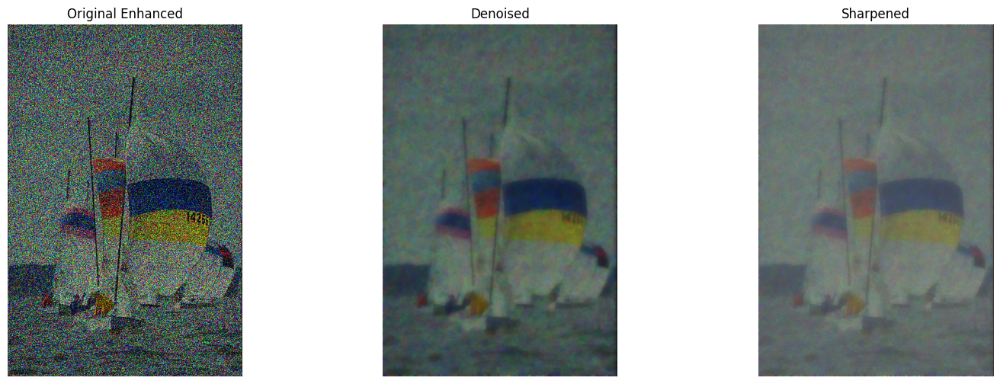

psnr enhanced, original 6.292186440624902


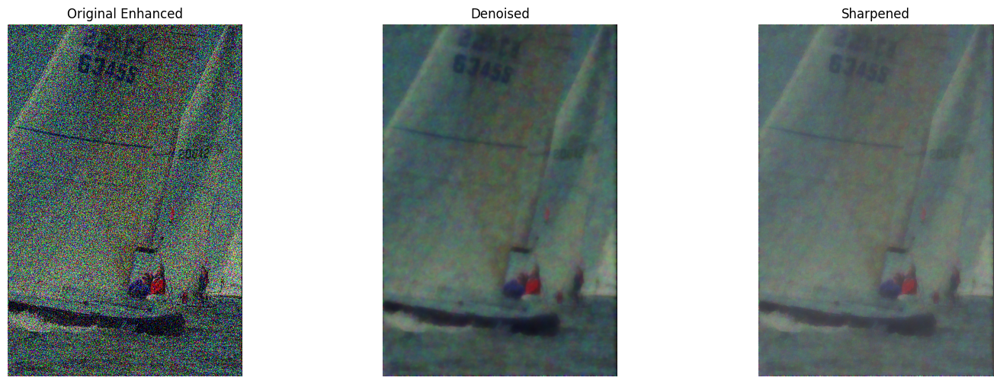

psnr enhanced, original 6.295367953393082


In [ ]:
from skimage.restoration import denoise_tv_chambolle
from skimage.restoration import denoise_tv_bregman
from skimage.restoration import denoise_bilateral, denoise_wavelet

denoised = []
sharpened = []

for i in range(len(enhanced)):
  denoised.append(denoise_tv_bregman(enhanced[i],  channel_axis=2, weight=0.28))

  kernel = np.array([[-0.75,-0.75,-0.75], [-0.75,9,-1], [-0.75,-0.75,-0.75]])  # Laplacian filter
  sharpened_image = cv2.filter2D(denoised[i], -1, kernel)
  sharpened.append(sharpened_image)

  #calculate PSNR
  sharpened_image = (sharpened_image - np.min(sharpened_image)) / (np.max(sharpened_image) - np.min(sharpened_image))
  psnr = peak_signal_noise_ratio(enhanced[i], sharpened_image,data_range=enhanced[i].max())


  #plot original enhanced image, denoised image, and sharpened image
  plt.figure(figsize=(18, 6))
  plt.subplot(1, 3, 1)
  plt.title('Original Enhanced')
  plt.imshow(enhanced[i])
  plt.axis('off')

  plt.subplot(1, 3, 2)
  plt.title('Denoised')
  plt.imshow(denoised[i])
  plt.axis('off')

  plt.subplot(1, 3, 3)
  plt.title(f'Sharpened')
  plt.imshow(sharpened_image)
  plt.axis('off')
  plt.show()
  print('psnr enhanced, original', psnr)



#print(mean_squared_error(enhanced[i], denoised[i]), peak_signal_noise_ratio(enhanced[i],denoised[i]) )